# Statistical Power

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from figure_functions import *
import cna, pickle, os, pp 
import scipy.stats as st
import anndata as ad
import scanpy as sc

res_folder="/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/"
fig_dir = "/data/srlab/lrumker/MCSC_Project/cna-qtl/figs/"

min_simulates = 20

In [2]:
# From Okabe & Ito, "colorblind-friendly" palette 
from matplotlib.colors import LinearSegmentedColormap
color_dict = {'orange': '#E69F00', 'skyblue': '#56B4E9', 'green': '#009E73', 
              'yellow': '#F0E442', 'purple': '#CC79A7', 'oceanblue': '#0072B2', 
              'vermillion': '#E63d00'} # O&I use '#D55E00'

## Primary statistical power estimation simulations

In [3]:
# Import results
res = pd.DataFrame({})
celltypes=['T', 'B', 'NK', 'Myeloid', 'allcells']
for i_celltype in np.arange(len(celltypes)):
    celltype=celltypes[i_celltype]
    new = pd.read_table('/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/results/'+celltype+\
                  "/GeNA_sumstats.txt").loc[:,["P", "ID"]]
    new.set_index('ID', inplace = True)
    new_meta = pd.read_table("/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/sim_genotypes/"+\
                             celltype+"_sim_genotypes_meta.tsv")
    new_meta.set_index('sim_id', inplace = True)
    new = new_meta.join(new)
    new.index = [celltype+"_"+new.index[i] for i in np.arange(new.shape[0])]
    new['perm_all'] = new.n_shuffle==new.n_shuffle.max()
    res = pd.concat([res, new])
    
# Add index across all traits, since 'trait' column indexes within type
res['type_trait'] = ["_".join(res.index[i].split("_")[:2]) for i in np.arange(res.shape[0])]

In [4]:
# Total count of traits
res.type_trait.value_counts().shape

(94,)

In [5]:
# Define bins for variance explained
mean_varexpl = np.arange(0, 1, step=0.02)
bins = np.arange(len(mean_varexpl))
res['bin'] = np.repeat(np.max(bins)+1, res.shape[0]) # placeholder
for sel_bin in bins:
    in_bin = np.logical_and(res.varexpl.values<(mean_varexpl[sel_bin]+0.01), 
                           res.varexpl.values>(mean_varexpl[sel_bin]-0.01))
    res.loc[in_bin,'bin'] = sel_bin
    
# remove empty bins
mean_varexpl = mean_varexpl[:(res.bin.max()+1)]
bins = bins[:(res.bin.max()+1)]

In [6]:
# Define our lowest bin to reflect simulates where the relationship between
# trait values and genotype was fully broken (n_shuffle == total samples)
to_rm = np.logical_and(res.bin==0, res.perm_all==False)
res = res.loc[~to_rm,:].reset_index()

p-value threshold of 5e-08, mean power at 2% var expl: 0.002861942817323398
p-value threshold of 5e-08, mean power at 6% var expl: 0.36982418910528836
p-value threshold of 5e-08, mean power at 12% var expl: 0.8592875319132552
p-value threshold of 5e-08, mean power at 14% var expl: 0.9394341225607451


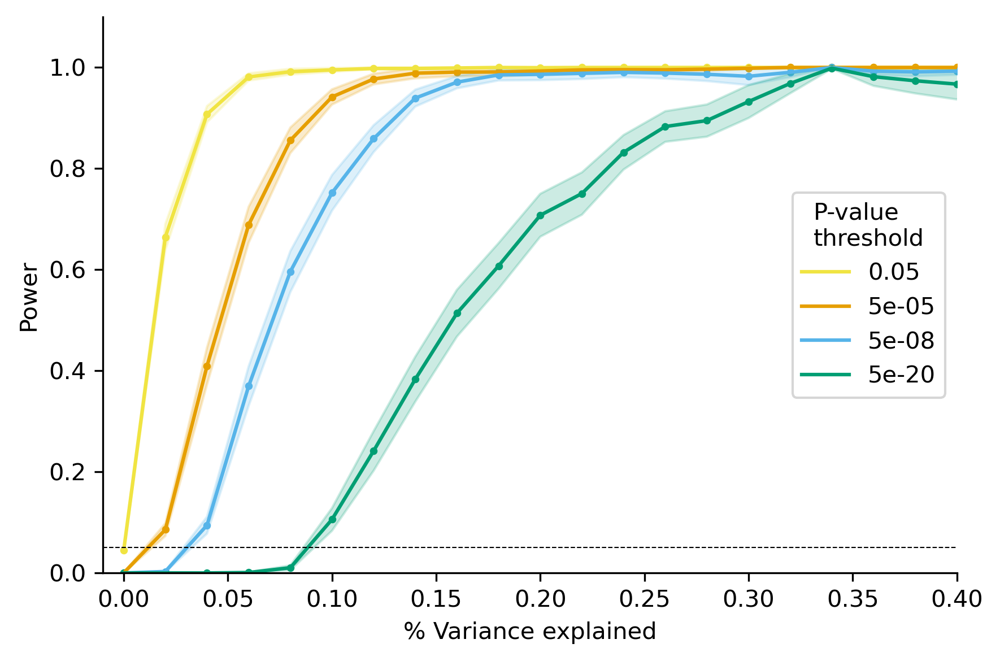

In [7]:
# Plot results
fig = plt.figure(figsize=(6,4), dpi = 300)
sel_colors=['yellow', 'orange', 'skyblue', 'green']
for i, p_thresh in enumerate([0.05, 5e-5, 5e-8, 5e-20]):
    res['power'] = 1*(res.P<p_thresh)
    res['n_simulates'] = np.ones(res.shape[0])

    power_per_trait_bin = res.groupby(['type_trait', 'bin']).mean().loc[:,['power']]
    count_per_trait_bin = res.groupby(['type_trait', 'bin']).sum().loc[:,['n_simulates']]

    power_per_trait_bin = power_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]
    count_per_trait_bin = count_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]

    mean_per_bin = power_per_trait_bin.groupby(['bin']).mean()['power'].values
    se_per_bin = power_per_trait_bin.groupby(['bin']).std()['power'].values \
                    / np.sqrt(power_per_trait_bin.groupby(['bin']).count()['power'].values)

    if p_thresh==5e-8:
        print("p-value threshold of "+str(p_thresh)+", mean power at 2% var expl: "+ str(mean_per_bin[1]))
        print("p-value threshold of "+str(p_thresh)+", mean power at 6% var expl: "+ str(mean_per_bin[3]))
        print("p-value threshold of "+str(p_thresh)+", mean power at 12% var expl: "+ str(mean_per_bin[6]))
        print("p-value threshold of "+str(p_thresh)+", mean power at 14% var expl: "+ str(mean_per_bin[7]))
        
        # Save values at selected percent variance explained
        mean_power_6pve=[]
        se_power_6pve=[]
        sel_bin = np.where(mean_varexpl==0.06)[0][0]
        mean_power_6pve.append(mean_per_bin[sel_bin])
        se_power_6pve.append(se_per_bin[sel_bin])
        
        mean_power_12pve=[]
        se_power_12pve=[]
        sel_bin = np.where(mean_varexpl==0.12)[0][0]
        mean_power_12pve.append(mean_per_bin[sel_bin])
        se_power_12pve.append(se_per_bin[sel_bin])
        
        mean_power_30pve=[]
        se_power_30pve=[]
        sel_bin = np.where(mean_varexpl==0.3)[0][0]
        mean_power_30pve.append(mean_per_bin[sel_bin])
        se_power_30pve.append(se_per_bin[sel_bin])
        
        mean_power_60pve=[]
        se_power_60pve=[]
        sel_bin = np.where(mean_varexpl==0.6)[0][0]
        mean_power_60pve.append(mean_per_bin[sel_bin])
        se_power_60pve.append(se_per_bin[sel_bin])
    
    plt.plot(mean_varexpl, mean_per_bin, c = color_dict[sel_colors[i]], label = p_thresh)
    plt.scatter(mean_varexpl, mean_per_bin, c = color_dict[sel_colors[i]], label = "_"+str(p_thresh), s = 5)
    plt.fill_between(mean_varexpl, mean_per_bin-se_per_bin, mean_per_bin+se_per_bin, 
                     color = color_dict[sel_colors[i]], alpha = 0.2)

plt.legend(title="P-value\nthreshold")
plt.axhline(y=0.05,linestyle="--", c = 'black', lw=0.5)
plt.xlabel("% Variance explained")
plt.ylabel("Power")
plt.ylim([0,1.1])
plt.xlim([-0.01,0.4])
plt.gca().spines[['right', 'top']].set_visible(False)
plt.tight_layout()
plt.savefig(fig_dir+"nonnull_sims.pdf", dpi = 300, transparent=True)
plt.savefig(fig_dir+"nonnull_sims.png", dpi = 300, transparent=True)
plt.show()

## Separate results among three major trait categories

In [8]:
min_simulates = 7

In [9]:
# Assign traits to respective phenotype categories
res['celltype'] = [res.type_trait[i].split("_")[0] for i in np.arange(res.shape[0])]
res['trait_num'] = [int(res.trait[i].split("T")[1]) for i in np.arange(res.shape[0])]
res['trait_name'] = np.repeat("",res.shape[0])

for celltype in ["T", "B", "NK", "allcells", "Myeloid"]:
    traits = pd.read_table("/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/traits/"+celltype+"_traits.txt")
    type_traits = pd.DataFrame(np.concatenate([np.array([""]), np.array(traits.columns[1:])]))
    res.loc[res.celltype==celltype,'trait_name'] = type_traits.iloc[res.loc[res.celltype==celltype,
                                                                    :].trait_num.values,0].values
    
res['trait_cat'] = np.repeat("celltype", res.shape[0])
res.loc[[res.trait_name.values[i][:3]=="hPC" for i in np.arange(res.shape[0])],'trait_cat']='GEP_global'
res.loc[[res.trait_name.values[i][-4::][:3]=="_PC" for i in np.arange(res.shape[0])],'trait_cat']='GEP_celltype'

In [10]:
all_res = res.copy()

In [11]:
# Load real dataset for phenotype examples
d = cna.read("/data/srlab/lrumker/datasets/onek1k/pheno/T.h5ad")
UMAP1 = d.obsm['X_umap'][:,0]
UMAP2 = d.obsm['X_umap'][:,1]
celltype_d = ad.AnnData(d.obsm['harmpca'][d.obs.celltype.values=='CD4 Naive',:20])
sc.tl.pca(celltype_d)
d.obs["type_PC"] = np.repeat(np.nan, d.obs.shape[0])
d.obs.loc[d.obs.celltype.values=="CD4 Naive","type_PC"]=celltype_d.obsm['X_pca'][:,1]

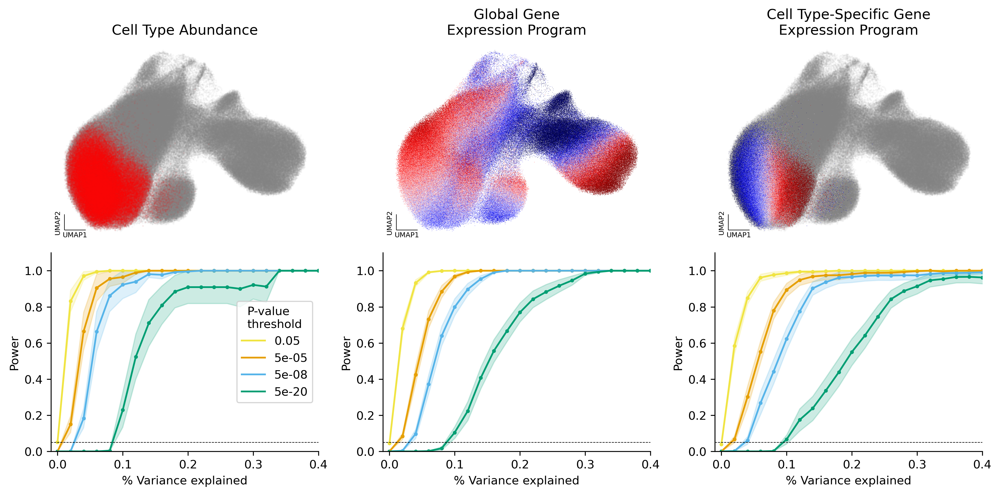

In [12]:
# Plot results
fig, axs = plt.subplots(2,3, figsize=(12,6), dpi = 300)
sel_colors=['yellow', 'orange', 'skyblue', 'green']

titles = ['Cell Type Abundance', 'Global Gene\nExpression Program', 'Cell Type-Specific Gene\nExpression Program']

ax = axs[0,0]
ax.scatter(UMAP1, UMAP2, c = "grey", s = 0.001)
ax.scatter(UMAP1[d.obs.celltype=="CD4 Naive"], UMAP2[d.obs.celltype=="CD4 Naive"], c = 'red', s = 0.001)
ax.set_title(titles[0])
add_umap_axes(ax, umap_axis_length = 0.08, umap_axis_offset = 0.05, 
              axis_lw = 0.5, umap_text_size = 6)

ax = axs[0,1]
pp.scatter_random(UMAP1, UMAP2, c = d.obsm['harmpca'][:,4], cmap = "seismic", ax = ax)
ax.set_title(titles[1])
add_umap_axes(ax, umap_axis_length = 0.08, umap_axis_offset = 0.05, 
              axis_lw = 0.5, umap_text_size = 6)

ax = axs[0,2]
ax.scatter(UMAP1, UMAP2, c = "grey", s = 0.001)
pp.scatter_random(UMAP1[d.obs.celltype=="CD4 Naive"], UMAP2[d.obs.celltype=="CD4 Naive"], 
                  c = d.obs.type_PC[d.obs.celltype=="CD4 Naive"], s = 0.001, cmap = "seismic", ax = ax)
ax.set_title(titles[2])
add_umap_axes(ax, umap_axis_length = 0.08, umap_axis_offset = 0.05, 
              axis_lw = 0.5, umap_text_size = 6)

for ax in [axs[0,0], axs[0,1], axs[0,2]]:
    ax.axis("off")

for t, trait_cat in enumerate(['celltype', 'GEP_global', 'GEP_celltype']):
    ax = axs[1,t]
    res = all_res.loc[all_res.trait_cat.values==trait_cat,:].reset_index()
    for i, p_thresh in enumerate([0.05, 5e-5, 5e-8, 5e-20]):
        res['power'] = 1*(res.P<p_thresh)
        res['n_simulates'] = np.ones(res.shape[0])

        power_per_trait_bin = res.groupby(['type_trait', 'bin']).mean().loc[:,['power']]
        count_per_trait_bin = res.groupby(['type_trait', 'bin']).sum().loc[:,['n_simulates']]

        power_per_trait_bin = power_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]
        count_per_trait_bin = count_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]

        mean_per_bin = power_per_trait_bin.groupby(['bin']).mean()['power'].values
        se_per_bin = power_per_trait_bin.groupby(['bin']).std()['power'].values \
                        / np.sqrt(power_per_trait_bin.groupby(['bin']).count()['power'].values)
        ax.plot(mean_varexpl, mean_per_bin, c = color_dict[sel_colors[i]], label = p_thresh)
        ax.scatter(mean_varexpl, mean_per_bin, c = color_dict[sel_colors[i]], label = "_"+str(p_thresh), s = 5)
        ax.fill_between(mean_varexpl, mean_per_bin-se_per_bin, mean_per_bin+se_per_bin, 
                         color = color_dict[sel_colors[i]], alpha = 0.2)
    if t==0:
        ax.legend(title="P-value\nthreshold")
    ax.axhline(y=0.05,linestyle="--", c = 'black', lw=0.5)
    ax.set_xlabel("% Variance explained")
    ax.set_ylabel("Power")
    ax.set_ylim([0,1.1])
    ax.set_xlim([-0.01,0.4])
    ax.spines[['right', 'top']].set_visible(False)
plt.tight_layout()
plt.savefig(fig_dir+"nonnull_sims_bycategory.png", dpi = 300, transparent=True)
plt.show()

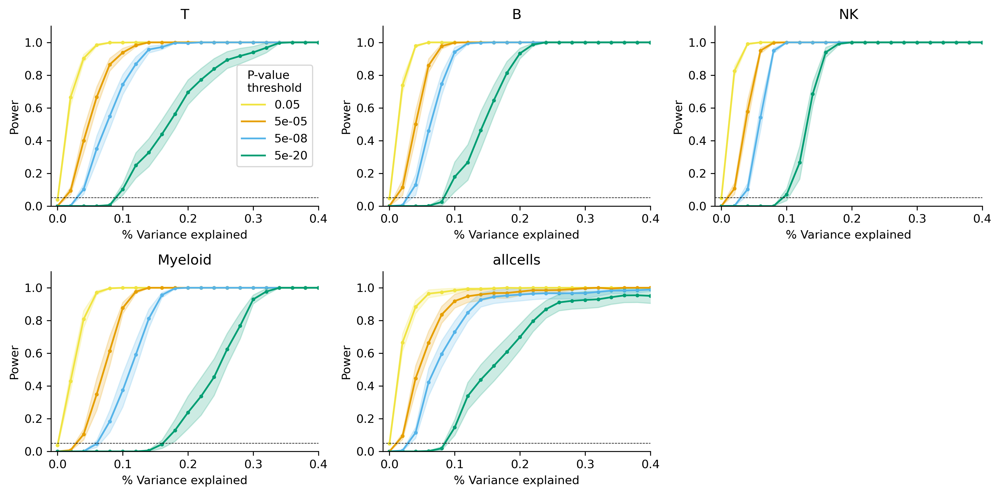

In [13]:
# Plot results by celltype
fig, axs = plt.subplots(2,3, figsize=(12,6), dpi = 300)
sel_colors=['yellow', 'orange', 'skyblue', 'green']

axs[1,2].axis("off")

for t, trait_cat in enumerate(celltypes):
    ax = axs.reshape(-1,)[t]
    res = all_res.loc[all_res.celltype.values==trait_cat,:].reset_index()
    for i, p_thresh in enumerate([0.05, 5e-5, 5e-8, 5e-20]):
        res['power'] = 1*(res.P<p_thresh)
        res['n_simulates'] = np.ones(res.shape[0])

        power_per_trait_bin = res.groupby(['type_trait', 'bin']).mean().loc[:,['power']]
        count_per_trait_bin = res.groupby(['type_trait', 'bin']).sum().loc[:,['n_simulates']]

        power_per_trait_bin = power_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]
        count_per_trait_bin = count_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]

        mean_per_bin = power_per_trait_bin.groupby(['bin']).mean()['power'].values
        se_per_bin = power_per_trait_bin.groupby(['bin']).std()['power'].values \
                        / np.sqrt(power_per_trait_bin.groupby(['bin']).count()['power'].values)
        ax.plot(mean_varexpl, mean_per_bin, c = color_dict[sel_colors[i]], label = p_thresh)
        ax.scatter(mean_varexpl, mean_per_bin, c = color_dict[sel_colors[i]], label = "_"+str(p_thresh), s = 5)
        ax.fill_between(mean_varexpl, mean_per_bin-se_per_bin, mean_per_bin+se_per_bin, 
                         color = color_dict[sel_colors[i]], alpha = 0.2)
    if t==0:
        ax.legend(title="P-value\nthreshold")
    ax.axhline(y=0.05,linestyle="--", c = 'black', lw=0.5)
    ax.set_xlabel("% Variance explained")
    ax.set_ylabel("Power")
    ax.set_ylim([0,1.1])
    ax.set_xlim([-0.01,0.4])
    ax.set_title(celltypes[t])
    ax.spines[['right', 'top']].set_visible(False)
plt.tight_layout()
plt.savefig(fig_dir+"nonnull_sims_bycelltype.png", dpi = 300, transparent=True)
plt.show()

## Relationship between power and sample size estimated with downsampling

In [14]:
# Import results
p_thresh = 5e-8
min_simulates = 20

for dataset_size in ['0pt8','0pt6','0pt4', '0pt2']:
    res = pd.DataFrame({})
    celltypes=['T', 'B', 'NK', 'Myeloid', 'allcells']

    for i_celltype in np.arange(len(celltypes)):
        celltype=celltypes[i_celltype]
        new = pd.read_table('/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/results/'+\
                            celltype+'/downsampled_'+dataset_size+\
                            "/GeNA_sumstats.txt").loc[:,["P", "ID"]]
        new.set_index('ID', inplace = True)
        new_meta = pd.read_table("/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/sim_genotypes/"+\
                                 celltype+"_"+dataset_size+"_sim_genotypes_meta.tsv")
        new_meta.set_index('sim_id', inplace = True)
        new = new_meta.join(new)
        new.index = [celltype+"_"+new.index[i] for i in np.arange(new.shape[0])]
        new['perm_all'] = new.n_shuffle==new.n_shuffle.max()
        res = pd.concat([res, new])

    # Add index across all traits, since 'trait' column indexes within type
    res['type_trait'] = ["_".join(res.index[i].split("_")[:2]) for i in np.arange(res.shape[0])]
    
    # Define bins for variance explained
    mean_varexpl = np.arange(0, 1, step=0.02)
    bins = np.arange(len(mean_varexpl))
    res['bin'] = np.repeat(np.max(bins)+1, res.shape[0]) # placeholder
    for sel_bin in bins:
        in_bin = np.logical_and(res.varexpl.values<(mean_varexpl[sel_bin]+0.01), 
                               res.varexpl.values>(mean_varexpl[sel_bin]-0.01))
        res.loc[in_bin,'bin'] = sel_bin

    # remove empty bins
    mean_varexpl = mean_varexpl[:(res.bin.max()+1)]
    bins = bins[:(res.bin.max()+1)]
    
    # compute power
    res['power'] = 1*(res.P<p_thresh)
    res['n_simulates'] = np.ones(res.shape[0])

    power_per_trait_bin = res.groupby(['type_trait', 'bin']).mean().loc[:,['power']]
    count_per_trait_bin = res.groupby(['type_trait', 'bin']).sum().loc[:,['n_simulates']]

    power_per_trait_bin = power_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]
    count_per_trait_bin = count_per_trait_bin.loc[count_per_trait_bin.n_simulates>=min_simulates,:]

    mean_per_bin = power_per_trait_bin.groupby(['bin']).mean()['power'].values
    se_per_bin = power_per_trait_bin.groupby(['bin']).std()['power'].values \
                    / np.sqrt(power_per_trait_bin.groupby(['bin']).count()['power'].values)

    # store results for selected variance explained threshold
    sel_bin = np.where(mean_varexpl==0.06)[0][0]
    mean_power_6pve.append(mean_per_bin[sel_bin])
    se_power_6pve.append(se_per_bin[sel_bin])
    
    sel_bin = np.where(mean_varexpl==0.12)[0][0]
    mean_power_12pve.append(mean_per_bin[sel_bin])
    se_power_12pve.append(se_per_bin[sel_bin])
    
    sel_bin = np.where(mean_varexpl==0.3)[0][0]
    mean_power_30pve.append(mean_per_bin[sel_bin])
    se_power_30pve.append(se_per_bin[sel_bin])
    
    sel_bin = np.where(mean_varexpl==0.6)[0][0]
    mean_power_60pve.append(mean_per_bin[sel_bin])
    se_power_60pve.append(se_per_bin[sel_bin])

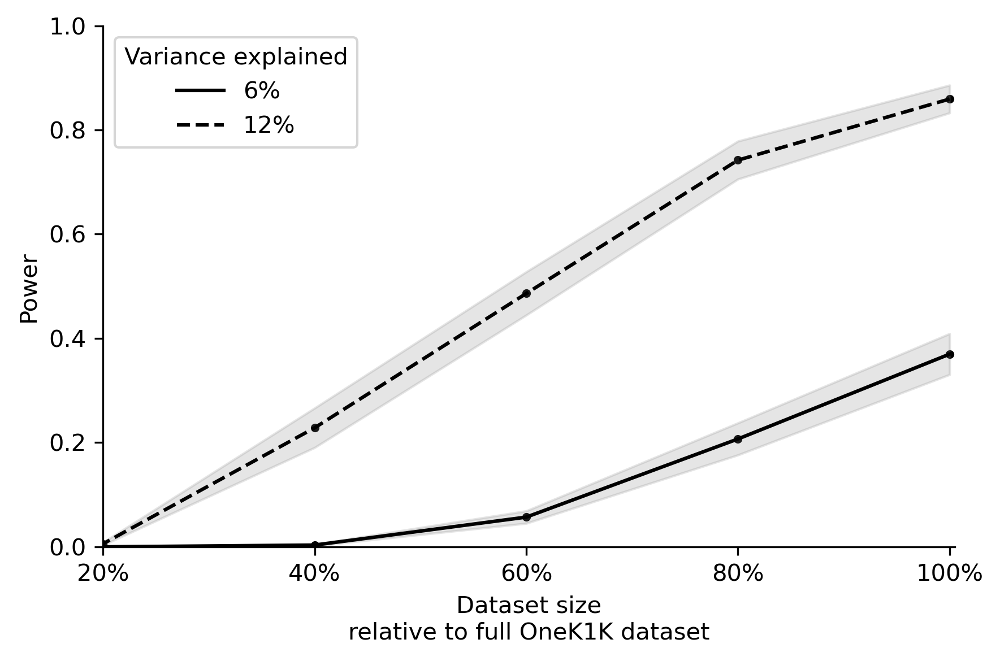

In [15]:
# Plot results
fig = plt.figure(figsize=(6,4), dpi = 300)

dataset_sizes = np.array([1, 0.8, 0.6, 0.4, 0.2])
mean_power_6pve = np.array(mean_power_6pve)
se_power_6pve = np.array(se_power_6pve)
plt.plot(dataset_sizes, mean_power_6pve, c = "black", label = "6%")
plt.scatter(dataset_sizes, mean_power_6pve, c = "black", s = 7, label = "_6%")
plt.fill_between(dataset_sizes, mean_power_6pve-se_power_6pve, 
                 mean_power_6pve+se_power_6pve, 
                 color = "grey", alpha = 0.2)

mean_power_12pve = np.array(mean_power_12pve)
se_power_12pve = np.array(se_power_12pve)
plt.plot(dataset_sizes, mean_power_12pve, c = "black", label = "12%", ls="--")
plt.scatter(dataset_sizes, mean_power_12pve, c = "black", s = 7, label = "_12%")
plt.fill_between(dataset_sizes, mean_power_12pve-se_power_12pve, 
                 mean_power_12pve+se_power_12pve, 
                 color = "grey", alpha = 0.2)

plt.legend(title="Variance explained")
plt.xlabel("Dataset size\nrelative to full OneK1K dataset")
plt.ylabel("Power")
plt.ylim([0,1])
plt.xlim([0.2,1.005])
plt.xticks(dataset_sizes[::-1], labels=['20%', '40%', '60%', '80%', '100%'])
plt.gca().spines[['right', 'top']].set_visible(False)
plt.tight_layout()
plt.savefig(fig_dir+"suppfig.downsample_power.pdf", dpi = 300, transparent=True)
plt.savefig(fig_dir+"suppfig.downsample_power.png", dpi = 300, transparent=True)
plt.show()

In [16]:
i=4 # Objects with 20% of full cohort size
print("30% var explained: power is " + str(mean_power_30pve[4]))
print("12% var explained: power is " + str(mean_power_12pve[4]))

30% var explained: power is 0.36730156082511156
12% var explained: power is 0.005799493845034642


In [17]:
# N per object with 20% of full cohort size
N_fraction = "0pt2"
for majortype in ["Myeloid", "allcells", "NK", "B", "T"]:
    sc_object="/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/downsampled/"+majortype+\
            "_"+N_fraction+".h5ad"
    d = cna.read(sc_object)
    print(majortype+" "+N_fraction+", N="+str(d.samplem.shape[0]))

Myeloid 0pt2, N=104
allcells 0pt2, N=193
NK 0pt2, N=187
B 0pt2, N=182
T 0pt2, N=193


## Variance in cell state abundance traits explained by csaQTLs published by Orrù et al.

In [18]:
ref = pd.read_table("/data/srlab/lrumker/MCSC_Project/cna-qtl/trait_replication/Orru_loci.txt")
ref = ref.loc[ref.Type!="MFI",:].reset_index()
ref = ref.loc[ref.Type!="Morphological parameter",:].reset_index()
ref.Type.value_counts()

Relative count    349
Absolute count    196
Name: Type, dtype: int64

In [19]:
orru_varexpl = ref['Heritability explained'].values
orru_varexpl = [orru_varexpl[i] for i in np.arange(len(orru_varexpl)) if not np.isnan(orru_varexpl[i])]
np.around(np.quantile(orru_varexpl, [0.05, 0.95]), 3)

array([0.008, 0.138])

## Illustrate diversity of simulated traits

In [20]:
# Count of traits for a single celltype
traits=pd.read_table("/data/srlab/lrumker/MCSC_Project/cna-qtl/nonnull_sims/traits/T_traits.txt",
                    index_col=0)
rm_traits = ['hPC1', 'hPC2', 'hPC3', 'hPC4', 'CD4 Naive_PC1', # traits with r^2>0.4 to any retained trait
            'frac_CD8 TEM', 'CD4 TCM_PC1', 'hPC9', 'CD4 TCM_PC2', 'hPC6', 'hPC10', 'CD8 Naive_PC3'] # traits with r^2>0.2 to any retained trait
traits = traits.drop(columns=rm_traits)
trait_cors = traits.corr()**2

In [21]:
np.sum(np.sum(trait_cors>0.2))==traits.shape[1] # no trait pair with r^2>0.2

True

In [22]:
traits.shape[1] # total traits retained

14

In [23]:
# Make trait names readable
trait_names = ["Global Program ".join(traits.columns[i].split('hPC')) \
 for i in np.arange(traits.shape[1])]
trait_names = [" Program ".join(trait_names[i].split('_PC')) \
 for i in np.arange(traits.shape[1])]
trait_names = [trait_names[i][5:]+" %T cells" if trait_names[i][:5] == "frac_" else trait_names[i] \
for i in np.arange(len(trait_names))]

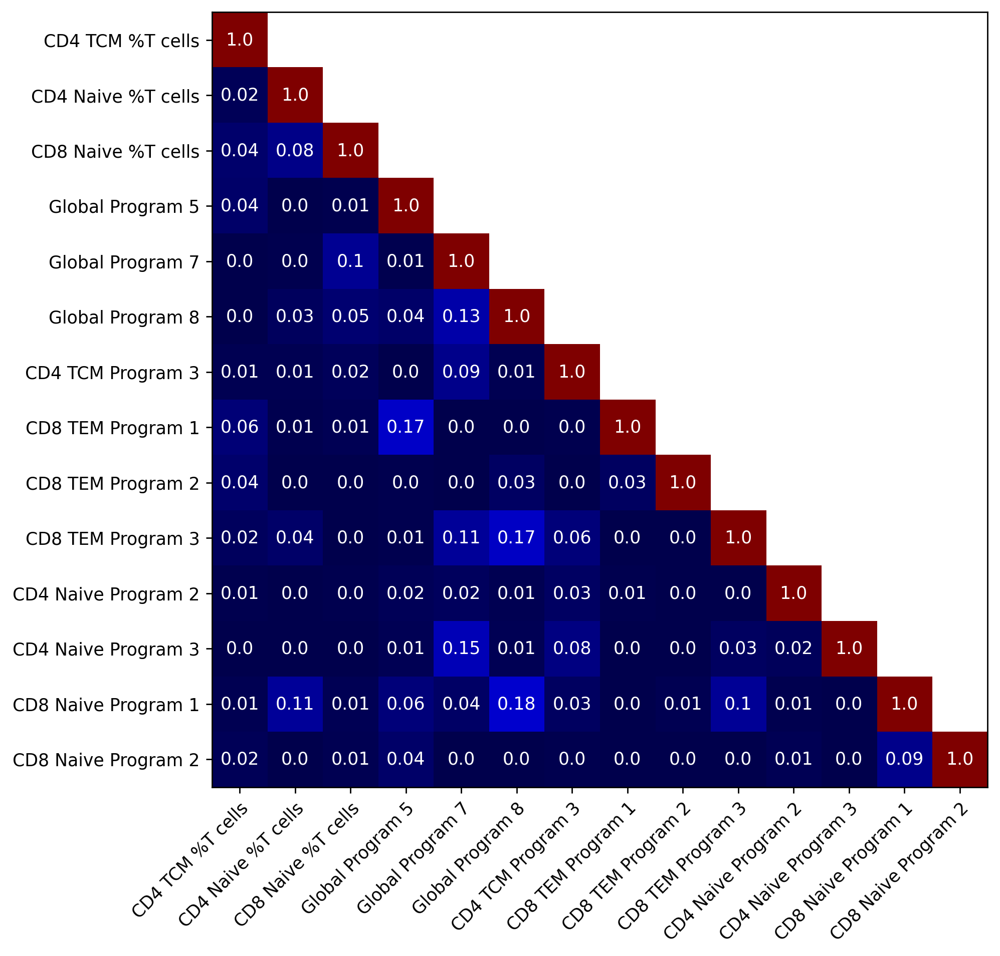

In [24]:
# Plot correlation heatmap
fig, axs = plt.subplots(1,1, figsize=(8,8), dpi = 250)
vals = trait_cors
mask = np.triu(vals, k=1)
vals = np.ma.array(vals, mask=mask)

ax = axs
im = plt.imshow(vals, cmap="seismic")
ax.set_xticks(np.arange(len(trait_names)))
ax.set_xticklabels(trait_names)
ax.set_yticks(np.arange(len(trait_names)))
ax.set_yticklabels(trait_names)
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
for i in range(len(trait_names)):
    for j in range(len(trait_names)):
        text = ax.text(j, i, np.around(vals[i, j],2),
                           ha="center", va="center", color="w")
plt.tight_layout()
plt.savefig(fig_dir+"suppfig.sim_T_trait_corrs.png", bbox_inches='tight')
plt.show()

In [25]:
# load T cell dataset
d = cna.read("/data/srlab/lrumker/datasets/onek1k/pheno/T.h5ad")
UMAP1 = d.obsm['X_umap'][:,0]
UMAP2 = d.obsm['X_umap'][:,1]

In [26]:
# Plot real traits for which we simulated associated SNPs
celltype_col="celltype"
celltypes = d.obs[celltype_col].value_counts().index
n_hPCs = 10
n_celltype_PCs = 3
# cell type fractional abundance                                                                                                                              
for celltype in celltypes:
    d.obs["frac_"+celltype] = 1*(d.obs[celltype_col].values==celltype)
    
# gene expression program
for i_hPC in np.arange(n_hPCs):
    d.obs['hPC'+str(i_hPC+1)] = d.obsm['harmpca'][:,i_hPC]
    
# cell type specific gene expression program
for celltype in celltypes:
    celltype_d = ad.AnnData(d.obsm['harmpca'][d.obs[celltype_col].values==celltype,:20])
    sc.tl.pca(celltype_d)
    for i_celltype_PC in np.arange(n_celltype_PCs):
        d.obs[celltype+"_PC"+str(i_celltype_PC+1)] = np.repeat(np.nan, d.obs.shape[0])
        d.obs.loc[d.obs[celltype_col].values==celltype,celltype+"_PC"+\
                  str(i_celltype_PC+1)]=celltype_d.obsm['X_pca'][:,i_celltype_PC]

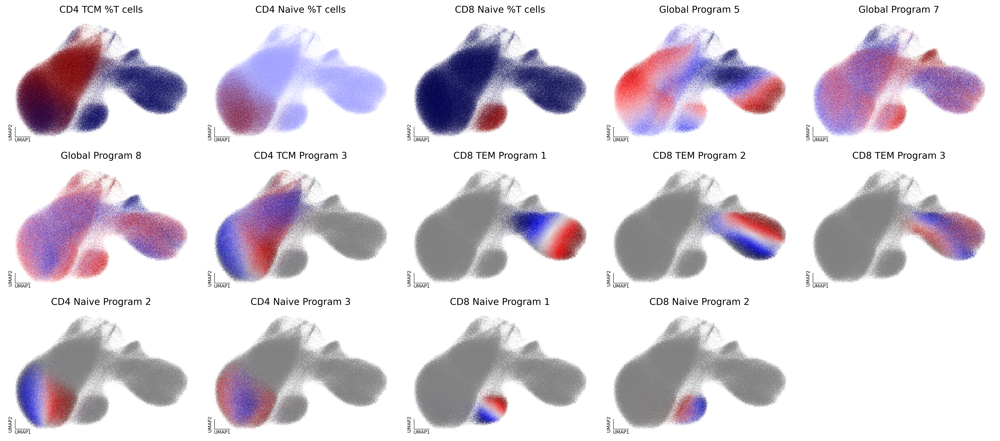

In [27]:
pp.umapprops['s'] = 0.06
fig, axes = plt.subplots(3,5, figsize = (18,8), dpi = 450)

for i in np.arange(traits.shape[1]):
    trait = d.obs[traits.columns].iloc[:,i]
    ax = axes.reshape(-1,)[i]
    mask = np.repeat(True, len(trait))
    if np.sum(pd.isna(trait)>0):
        ax.scatter(UMAP1, UMAP2, c = "grey", s = 0.1, edgecolor = 'none')
        mask = ~pd.isna(trait)
        pp.scatter_random(UMAP1[mask], UMAP2[mask], c = trait[mask].values, cmap = "seismic", ax = ax)
    else:
        c = (trait.values-np.mean(trait.values))/np.std(trait.values)
        pp.scatter_random(UMAP1[mask], UMAP2[mask], c = c, cmap = "seismic", ax = ax)
    ax.set_title(trait_names[i])

for i in np.arange(len(axes.reshape(-1,))):
    ax = axes.reshape(-1,)[i]
    ax.axis("off")
    if i < (len(axes.reshape(-1,))-1):
        add_umap_axes(ax, umap_axis_length = 0.08, umap_axis_offset = 0.05, 
              axis_lw = 0.5, umap_text_size = 6)
    
plt.tight_layout()
plt.savefig(fig_dir+"suppfig.sim_T_trait_umaps.pdf", bbox_inches='tight')
plt.savefig(fig_dir+"suppfig.sim_T_trait_umaps.png", bbox_inches='tight')
plt.show()